<div>
<a href="http://www.music-processing.de/"><img style="float:left;" src="../data/FMP_Teaser_Cover.png" width=40% alt="FMP"></a>
<a href="https://www.audiolabs-erlangen.de"><img src="../data/Logo_AudioLabs_Long.png" width=59% style="float: right;" alt="AudioLabs"></a>
</div>

<div>
<a href="../C8/C8.html"><img src="../data/C8_nav.png" width="100"  style="float:right;" alt="C8"></a>
<h1>Harmonic&ndash;Percussive Separation (HPS)</h1> 
</div>

<br/>

<p>
Following Section 8.1.1 of <a href="http://www.music-processing.de/">[Müller, FMP, Springer 2015]</a>, we cover in this notebook a basic approach for separating a signal into a harmonic and a percussive component. This approach was originally introduced by Derry FitzGerald:

<ul>
<li><span style="color:black">
Derry FitzGerald: <strong>Harmonic/Percussive Separation Using Median Filtering.</strong> Proceedings of the International Conference on Digital Audio Effects (DAFx), Graz, Austria, 2010, pp. 246&ndash;253.
<br>
<a type="button" class="btn btn-default btn-xs" target="_blank" href="../data/bibtex/FMP_bibtex_Fitzgerald10_HarmPercSep_DAFX.txt"> Bibtex </a>
</span></li>    
</ul>    
</p> 

## Harmonic and Percussive Sounds

Musical sounds can comprise a wide range of sound components with different acoustic qualities. In particular, we  consider two broad categories of sounds: harmonic sounds and percussive sounds. Loosely speaking, a **harmonic sound** is what we perceive as pitched sound, what makes us hear melodies and chords. The prototype of a harmonic sound is the acoustic realization of a sinusoid, which corresponds to a **horizontal line in a spectrogram representation**. The sound of a violin is another typical example of what we consider a harmonic sound. Again, most of the observed structures in the spectrogram are of horizontal nature (even though they are intermingled with noise-like components). On the other hand, a **percussive sound** is what we perceive as a clash, a knock, a clap, or a click. The sound of a drum stroke or a transient that occurs in the attack phase of a musical tone are further typical examples. The prototype of a percussive sound is the acoustic realization of an impulse, which corresponds to a **vertical line in a spectrogram representation**. 

In the following example, we show the spectrogram representations (using logarithmic compression) of a violin recording, a recording of castanets, and a superposition of these two recordings. For the violin sound one can observe horizontal lines that are stacked on top of each other, which correspond to the harmonics, the integer multiples of the fundamental frequency of a played note.

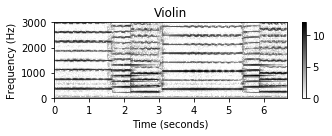

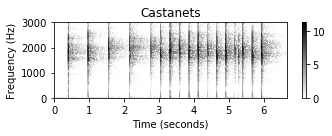

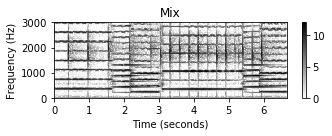

In [1]:
import os, sys
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
import IPython.display as ipd
import librosa.display
import soundfile as sf
sys.path.append('..')
import libfmp.b

%matplotlib inline

def compute_plot_spectrogram(x, Fs=22050, N=4096, H=2048, ylim=None,
                     figsize =(5, 2), title='', log=False):
    N, H = 1024, 512
    X = librosa.stft(x, n_fft=N, hop_length=H, win_length=N, window='hann', 
                     center=True, pad_mode='constant')
    Y = np.abs(X)**2
    if log:
        Y_plot = np.log(1 + 100 * Y)
    else:
        Y_plot = Y
    libfmp.b.plot_matrix(Y_plot, Fs=Fs/H, Fs_F=N/Fs, title=title, figsize=figsize)
    if ylim is not None:
        plt.ylim(ylim)
    plt.tight_layout()
    plt.show()
    return Y

Fs = 22050
fn_wav = os.path.join('..', 'data', 'C8', 'FMP_C8_F02_Long_Violin.wav')
x, Fs = librosa.load(fn_wav, sr=Fs)
Y = compute_plot_spectrogram(x, Fs=Fs, title = 'Violin', ylim=[0, 3000], log=1)
ipd.display(ipd.Audio(data=x, rate=Fs))

fn_wav = os.path.join('..', 'data', 'C8', 'FMP_C8_F02_Long_Castanets.wav')
x, Fs = librosa.load(fn_wav, sr=Fs)
Y = compute_plot_spectrogram(x, Fs=Fs, title = 'Castanets', ylim=[0, 3000], log=1)
ipd.display(ipd.Audio(data=x, rate=Fs))

fn_wav = os.path.join('..', 'data', 'C8', 'FMP_C8_F02_Long_CastanetsViolin.wav')
x, Fs = librosa.load(fn_wav, sr=Fs)
Y = compute_plot_spectrogram(x, Fs=Fs, title = 'Mix', ylim=[0, 3000], log=1)
ipd.display(ipd.Audio(data=x, rate=Fs))

## Basic Idea

The goal of **harmonic&ndash;percussive separation** (HPS) is to decompose a given audio signal into two parts: one consisting of the harmonic and another of the percussive events. This task is rather vague since it often remains unclear whether a sound event is actually of harmonic or percussive nature. Indeed, there are many sounds such as white noise or applause which are neither harmonic nor percussive. Closely following the work by Fitzgerald, we introduce an HPS procedure as illustrated in the figure below. The idea is to filter a spectrogram representation of the given signal in the **horizontal direction (along time)** to enhance harmonic events while suppressing percussive ones. Similarly, the spectrogram is filtered in the **vertical direction (along frequency)** to enhance percussive events while suppressing harmonic ones. The two resulting filtered spectrograms are used to generate **time&ndash;frequency masks**, which are then applied to the original spectrogram. From the masked spectrogram representations, the harmonic and percussive parts of the signal are obtained by applying an inverse STFT. 

<img src="../data/C8/FMP_C8_F03.png" width="500px" align="middle" alt="FMP_C8_F03">

## Notation

In the following, let $x:\mathbb{Z}\to\mathbb{R}$ be a discrete-time representation of a sampled audio signal. The objective is to decompose $x$ into a harmonic component signal $x^\mathrm{h}:\mathbb{Z}\to\mathbb{R}$ and a percussive component signal $x^\mathrm{p}:\mathbb{Z}\to\mathbb{R}$ such that 

\begin{equation}
   x = x^\mathrm{h} + x^\mathrm{p}. 
\end{equation}

In the first step, we compute  the [discrete STFT](../C2/C2_STFT-Basic.html) $\mathcal{X}$ of the signal $x$. For convenience, we repeat its definition:

\begin{equation}
    \mathcal{X}(n,k):= \sum_{r=0}^{N-1} x(r + n H)w(r)\exp(-2\pi ikr/N),
\end{equation}

where $w:[0:N-1]\to\mathbb{R}$ is a suitable window function of length $N$ and $H$ is the hop size parameter. To avoid boundary considerations at later stages, we may assume that $n\in\mathbb{Z}$ and $k\in\mathbb{Z}$ by applying a suitable **zero-padding** of the matrix $\mathcal{X}$ in the time as well as frequency direction. From $\mathcal{X}$, we derive the (power) spectrogram $\mathcal{Y}$:

\begin{eqnarray}
   \mathcal{Y}(n,k):= |\mathcal{X}(n,k)|^2.
\end{eqnarray}

In our code examples, we use the ``librosa``-implementation to compute the STFT. The window size and hop size parameters are very important and have a substantial effect on the final separation result. We discuss the role of these parameters at the end of this notebook.

## Median Filtering

In the next step, we compute a **harmonically enhanced** spectrogram $\tilde{{\mathcal Y}}_\mathrm{h}$ and a **percussively enhanced** spectrogram $\tilde{{\mathcal Y}}_\mathrm{p}$ by filtering ${\mathcal Y}$. To this end, we apply the concept of **median filtering**. The **median** of a finite list of numbers is the numerical value with the property that half the numbers fall below the value and half above it. The median can be computed by arranging all the numbers from lowest value to highest value and picking the middle one. If there is an even number of observations, then there is no single middle value; the median is then usually defined to be the mean of the two middle values. For example, the median of the list $(5,3,2,8,2)$ is $3$, while the median of the  list $(5,3,2,8)$ is $4$. 

More formally, let $A = (a_1,a_2,\ldots,a_L)$ be a list of length $L\in\mathbb{N}$ consisting of real numbers $a_\ell\in\mathbb{R}$, $\ell\in[1:L]$. First, the elements of $A$ are sorted in ascending order. This results in a list $\tilde{A}=(\tilde{a}_1,\tilde{a}_2,\ldots,\tilde{a}_L)$ with $\tilde{a}_\ell\leq \tilde{a}_m$ for $\ell<m$ and $\ell,m\in[1:L]$. Then, the median $\mu_{1/2}(A)$ of $A$ is defined as

\begin{equation}
\mu_{1/2}(A) := \begin{cases} \tilde{a}_{(L+1)/2}, & \mbox{for $L$ being odd,}\\ 
    (\tilde{a}_{L/2} + \tilde{a}_{L/2+1})/2, & \mbox{otherwise}.
    \end{cases}
\end{equation}

The median can be applied in a local fashion to a sequence of real numbers. To this end, one replaces a given element in the sequence by the median defined by the elements that lie in a suitably defined neighborhood of the given element. This leads us to the concept of a  **median filter** of length $L\in\mathbb{N}$. Let $A=(a_n\mid n\in\mathbb{Z})$ be a sequence of real numbers $a_n\in\mathbb{R}$ and $L\in\mathbb{N}$ be an integer. Then the sequence 
$\mu_{1/2}^L[A]$ is defined by 

\begin{equation}
\label{eq:AudioDeco:HPS:SD:medianFilter}
   \mu_{1/2}^L[A](n) = \mu_{1/2}\big((a_{n-(L-1)/2},\ldots, a_{n+(L-1)/2})\big).
\end{equation}

For example, consider the sequence $A=(\ldots,0,5,3,2,8,2,0,\ldots)$, where we assume that $A$ is zero outside the shown values. Using $L=3$, we obtain $\mu_{1/2}^L[A]=(\ldots,0,3,3,3,2,2,0,\ldots)$.

The function ``signal.medfilt`` from the ``scipy``-package applies a median filter to an input signal, where the length is determined by the parameter `kernel_size` (which is assumed to be an odd integer). Applying zero padding, the output signal has the same size as input. 

In [2]:
A = np.array([5.,3,2,8,2])
filter_len = 3
A_result = signal.medfilt(A, kernel_size=filter_len)
print('A        = ', A)
print('A_result = ', A_result)

A        =  [5. 3. 2. 8. 2.]
A_result =  [3. 3. 3. 2. 2.]


## Horizontal and Vertical Median Filtering

In our scenario, we apply the concept of **median filtering** to the spectrogram $\mathcal{Y}$ in two ways: once **horizontally** by considering rows of $\mathcal{Y}$ and once **vertically** by considering columns of $\mathcal{Y}$. This yields two filtered spectrograms which we denote by $\tilde{\mathcal{Y}}^\mathrm{h}$ and $\tilde{\mathcal{Y}}^\mathrm{p}$, respectively. More precisely, let $L^\mathrm{h}$ and $L^\mathrm{p}$ be odd length parameters, then we define

\begin{eqnarray}
   \tilde{\mathcal{Y}}^\mathrm{h}(n,k)&:=&\mu_{1/2}((\mathcal{Y}(n-(L^\mathrm{h}-1)/2,k),\ldots, \mathcal{Y}(n+(L^\mathrm{h}-1)/2,k))), \\ 
   \tilde{\mathcal{Y}}^\mathrm{p}(n,k)&:=&\mu_{1/2}((\mathcal{Y}(n,k-(L^\mathrm{p}-1)/2),\ldots, \mathcal{Y}(n,k+(L^\mathrm{p}-1)/2)))
\end{eqnarray}

for $n,k\in\mathbb{Z}$ (assuming some suitable zero-padding of $\mathcal{Y}$). As an example, let us come back to the example of a volin recording (harmonic component) superimposed by castanet clicks (percussive component). When applying a median filter in the horizontal direction, the horizontal structures become more apparent, whereas the vertical structures vanish. When applying a median filter in the vertical direction, one obtains similar enhancement effects, this time for the percussive structures

/home/ssl/miniconda3/envs/FMP/lib/python3.7/site-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


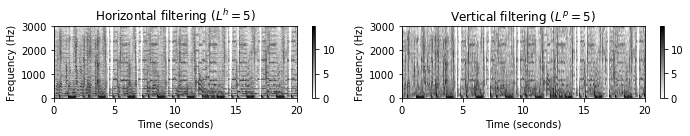

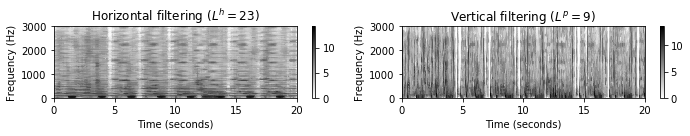

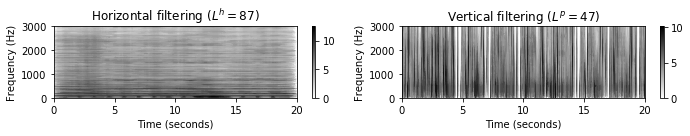

In [3]:
def median_filter_horizontal(x, filter_len):
    """Apply median filter in horizontal direction

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        x (np.ndarray): Input matrix
        filter_len (int): Filter length

    Returns:
        x_h (np.ndarray): Filtered matrix
    """
    return signal.medfilt(x, [1, filter_len])

def median_filter_vertical(x, filter_len):
    """Apply median filter in vertical direction

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        x: Input matrix
        filter_len (int): Filter length

    Returns:
        x_p (np.ndarray): Filtered matrix
    """
    return signal.medfilt(x, [filter_len, 1])

def plot_spectrogram_hp(Y_h, Y_p, Fs=22050, N=4096, H=2048, figsize =(10, 2), 
                         ylim=None, clim=None, title_h='', title_p='', log=False):
    if log: 
        Y_h_plot = np.log(1 + 100 * Y_h)
        Y_p_plot = np.log(1 + 100 * Y_p)
    else: 
        Y_h_plot = Y_h
        Y_p_plot = Y_p
    plt.figure(figsize=figsize)
    ax = plt.subplot(1,2,1)
    libfmp.b.plot_matrix(Y_h_plot, Fs=Fs/H, Fs_F=N/Fs, ax=[ax], clim=clim,
                         title=title_h, figsize=figsize)
    if ylim is not None:
        ax.set_ylim(ylim)
        
    ax = plt.subplot(1,2,2)
    libfmp.b.plot_matrix(Y_p_plot, Fs=Fs/H, Fs_F=N/Fs, ax=[ax], clim=clim,
                         title=title_p, figsize=figsize)
    if ylim is not None:
        ax.set_ylim(ylim)
  
    plt.tight_layout()
    plt.show()
    
Fs = 22050
fn_wav = os.path.join('..', 'Project', 'music', 'candyshop.mp3')
x_full, Fs = librosa.load(fn_wav, sr=Fs, mono=True)
x = x_full[70*Fs:90*Fs]
N, H = 1024, 512
X = librosa.stft(x, n_fft=N, hop_length=H, win_length=N, window='hann', center=True, pad_mode='constant')
Y = np.abs(X)**2

L_set = np.array([[5,5],[23,9],[87,47]])
num = L_set.shape[0]
for m in range(num):
    L_h = L_set[m,0]
    L_p = L_set[m,1]
    Y_h = median_filter_horizontal(Y, L_h)
    Y_p = median_filter_vertical(Y, L_p)
    title_h = r'Horizontal filtering ($L^h=%d$)'%L_h
    title_p = r'Vertical filtering ($L^p=%d$)'%L_p
    plot_spectrogram_hp(Y_h, Y_p, Fs=Fs, N=N, H=H, 
            title_h=title_h, title_p=title_p, ylim=[0, 3000], log=True)

## Binary and Soft Masking

The two filtered spectrograms $\tilde{\mathcal{Y}}^\mathrm{h}$ and $\tilde{\mathcal{Y}}^\mathrm{p}$ are not directly applied for constructing the harmonic and percussive components of the signal. Instead, they are used to first generate two masks which, in turn, are then employed for "punching out" the desired components from the original spectrogram. There are various types of time&ndash;frequency masks one may derive from  $\tilde{\mathcal{Y}}^\mathrm{h}$ and $\tilde{\mathcal{Y}}^\mathrm{p}$. The first type is referred to as a **binary mask**, where each time&ndash;frequency bin is assigned either the value one or the value zero. In the binary case, we define the two masks by setting

\begin{eqnarray}
\mathcal{M}^\mathrm{h}(n,k) &:=& 
\begin{cases}
   1, & \text{if } \tilde{\mathcal{Y}}^\mathrm{h}(n,k) \geq \tilde{\mathcal{Y}}^\mathrm{p}(n,k), \\
   0, & \text{otherwise,}
  \end{cases} \\ 
\mathcal{M}^\mathrm{p}(n,k) &:=& 
\begin{cases}
   1, & \text{if } \tilde{\mathcal{Y}}^\mathrm{h}(n,k) < \tilde{\mathcal{Y}}^\mathrm{p}(n,k), \\
   0, & \text{otherwise}
  \end{cases}
\end{eqnarray}

Instead of a binary (hard) decision, one can consider a relative weighting when comparing the magnitudes of spectral coefficients. This leads us to another type of mask also known as a **soft mask**. In this case, we define the two masks by setting

\begin{eqnarray}
\mathcal{M}^\mathrm{h}(n,k) &:=& \frac{\tilde{\mathcal{Y}}^\mathrm{h}(n,k)+\varepsilon/2}{\tilde{\mathcal{Y}}^\mathrm{h}(n,k) +\tilde{\mathcal{Y}}^\mathrm{p}(n,k)+\varepsilon}, \\
\mathcal{M}^\mathrm{p}(n,k) &:=& \frac{\tilde{\mathcal{Y}}^\mathrm{p}(n,k)+\varepsilon/2}{\tilde{\mathcal{Y}}^\mathrm{h}(n,k) + \tilde{\mathcal{Y}}^\mathrm{p}(n,k)+\varepsilon}
\end{eqnarray} 

for $n,k\in\mathbb{Z}$. The small positive value $\varepsilon>0$ is added to avoid division by zero.

A (binary or soft) time&ndash;frequency mask expresses the extent to which each of the time&ndash;frequency bins belongs to the respective component. To obtain the component, the mask is applied to the original spectrogram by pointwise multiplication. In the case of the harmonic and percussive masks, this yields two masked versions $\mathcal{Y}^\mathrm{h}$ and $\mathcal{Y}^\mathrm{p}$ defined by

\begin{eqnarray}
\mathcal{Y}^\mathrm{h}(n,k) &:=& \mathcal{M}^\mathrm{h}(n,k) \cdot \mathcal{Y}(n,k), \\
\mathcal{Y}^\mathrm{p}(n,k) &:=& \mathcal{M}^\mathrm{p}(n,k) \cdot \mathcal{Y}(n,k)
\end{eqnarray} 

for $n,k\in\mathbb{Z}$. In the case of binary masks, a mask value of one preserves the value in the spectrogram, while a mask value of zero suppresses it. In other words, every time&ndash;frequency bin of $\mathcal{Y}$ is assigned either to $\mathcal{Y}^\mathrm{h}$ or to $\mathcal{Y}^\mathrm{p}$. In the case of soft masks, this assignment is not strict but proportionate as expressed by the masking weights.  This kind of spectral manipulation is also known as **Wiener filtering**, which is an important concept in statistical digital signal processing.

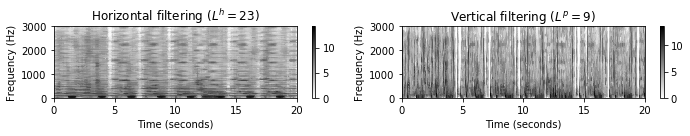

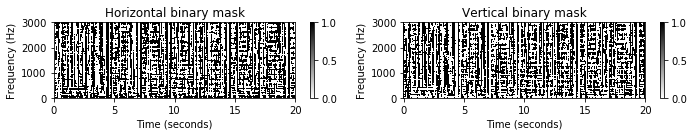

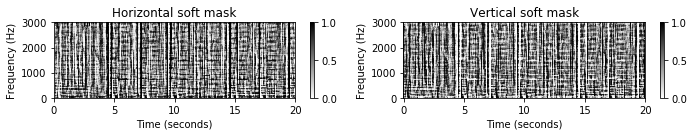

In [4]:
L_h = 23
L_p = 9
Y_h = median_filter_horizontal(Y, L_h)
Y_p = median_filter_vertical(Y, L_p)
title_h = r'Horizontal filtering ($L^h=%d$)'%L_h
title_p = r'Vertical filtering ($L^p=%d$)'%L_p
plot_spectrogram_hp(Y_h, Y_p, Fs=Fs, N=N, H=H, 
        title_h=title_h, title_p=title_p, ylim=[0, 3000], log=True)

M_binary_h = np.int8(Y_h >= Y_p)
M_binary_p = np.int8(Y_h < Y_p)
title_h = r'Horizontal binary mask'
title_p = r'Vertical binary mask'
plot_spectrogram_hp(M_binary_h, M_binary_p, Fs=Fs, N=N, H=H, clim=[0,1],
        title_h=title_h, title_p=title_p, ylim=[0, 3000])

eps = 0.00001
M_soft_h = (Y_h + eps/2)/(Y_h + Y_p + eps)
M_soft_p = (Y_p + eps/2)/(Y_h + Y_p + eps)
title_h = r'Horizontal soft mask'
title_p = r'Vertical soft mask'
plot_spectrogram_hp(M_soft_h, M_soft_p, Fs=Fs, N=N, H=H, clim=[0,1],
        title_h=title_h, title_p=title_p, ylim=[0, 3000])

## Signal Reconstruction

So far, we have decomposed the spectrogram $\mathcal{Y}$ of the signal into two components $\mathcal{Y}^\mathrm{h}$ and $\mathcal{Y}^\mathrm{p}$. The most convenient way to obtain two time-domain signals $x^\mathrm{h}$ and $x^\mathrm{p}$ is to apply the two masks directly to the original STFT $\mathcal{X}$, yielding two complex-valued masked STFTs $\mathcal{X}^\mathrm{h}$ and $\mathcal{X}^\mathrm{p}$:

\begin{eqnarray}
\mathcal{X}^\mathrm{h}(n,k) &:=& \mathcal{M}^\mathrm{h}(n,k) \cdot \mathcal{X}(n,k), \\
\mathcal{X}^\mathrm{p}(n,k) &:=& \mathcal{M}^\mathrm{p}(n,k) \cdot \mathcal{X}(n,k)
\end{eqnarray} 

for $n,k\in\mathbf{Z}$. Then, an inverse STFT is applied to the masked STFTs to obtain time-domain signal $x^\mathrm{h}$ and $x^\mathrm{p}$. Note that this procedure is more problematic than it might seem at first glance. First, simply using the same phase information of $\mathcal{X}$ for both components $\mathcal{X}^\mathrm{h}$ and $\mathcal{X}^\mathrm{p}$ does not account for a possible **phase interference** between different signal components. In general, the estimation of coherent phase information for different signal components is very hard or even intractable.  A second problem arises from the fact that manipulating an STFT (e.g., by applying a mask) may cause problems in the reconstruction of a coherent time-domain signal. We will cover such aspects in the <a href="../C8/C8S1_SignalReconstruction.html">FMP notebook on signal reconstruction</a> (see also Section 8.1.2 of <a href="http://www.music-processing.de/">[Müller, FMP, Springer 2015]</a>)

In the following example, we only consider the case of binary masking. For reconstructing the signal from the masked STFT, we use the function `librosa.istft`.

In [5]:
X_h = X * M_binary_h
X_p = X * M_binary_p

x_h = librosa.istft(X_h, hop_length=H, win_length=N, window='hann', center=True, length=x.size)
x_p = librosa.istft(X_p, hop_length=H, win_length=N, window='hann', center=True, length=x.size)

print('Harmonic component signal')
ipd.display(ipd.Audio(data=x_h, rate=Fs))
print('Percussive component signal')
ipd.display(ipd.Audio(data=x_p, rate=Fs))

output_fn = os.path.join('..', 'output', 'C8', 'x_h.wav')
sf.write(output_fn, x_h, Fs)
output_fn = os.path.join('..', 'output', 'C8', 'x_p.wav')
sf.write(output_fn, x_p, Fs)

Harmonic component signal


Percussive component signal


## Physical Interpretation of Parameters

In the HPS procedure discussed so far, there are many parameters to choose including the window length $N$ and hop size $H$ of the STFT as well as the filter lengths $L^\mathrm{h}$ and $L^\mathrm{p}$ used for the median filtering. So far, the parameters $L^\mathrm{h}$ and $L^\mathrm{p}$ are specified in terms of indices (i.e., frames and bins). To choose these parameters in a meaningful way, one needs to understand their physical interpretation in terms of seconds and Hertz, respectively. Given the sampling rate $F_\mathrm{s}$ of the input signal $x$ as well as the frame length $N$ and the hopsize $H$, the following functions convert the filter lengths given in seconds and Hertz to filter lengths given in indices. As for the median filtering, one needs to ensure that the filter lengths are odd integers.

In [6]:
def convert_l_sec_to_frames(L_h_sec, Fs=22050, N=1024, H=512):
    """Convert filter length parameter from seconds to frame indices

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        L_h_sec (float): Filter length (in seconds)
        Fs (scalar): Sample rate (Default value = 22050)
        N (int): Window size (Default value = 1024)
        H (int): Hop size (Default value = 512)

    Returns:
        L_h (int): Filter length (in samples)
    """
    L_h = int(np.ceil(L_h_sec * Fs / H))
    return L_h


def convert_l_hertz_to_bins(L_p_Hz, Fs=22050, N=1024, H=512):
    """Convert filter length parameter from Hertz to frequency bins

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        L_p_Hz (float): Filter length (in Hertz)
        Fs (scalar): Sample rate (Default value = 22050)
        N (int): Window size (Default value = 1024)
        H (int): Hop size (Default value = 512)

    Returns:
        L_p (int): Filter length (in frequency bins)
    """
    L_p = int(np.ceil(L_p_Hz * N / Fs))
    return L_p


def make_integer_odd(n):
    """Convert integer into odd integer

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        n (int): Integer

    Returns:
        n (int): Odd integer
    """
    if n % 2 == 0:
        n += 1
    return n

Fs, N, H = 22050, 1024, 512
print('L_h(%.1f sec) = %d' % (0.5, make_integer_odd(convert_l_sec_to_frames(0.5, Fs=Fs, N=N, H=H)) ))
print('L_p(%.1f Hz) = %d' % (600, make_integer_odd(convert_l_hertz_to_bins(600, Fs=Fs, N=N, H=H)) ))

L_h(0.5 sec) = 23
L_p(600.0 Hz) = 29


## HPS Implementation

In the following code cell, we present a function ``hps`` that implements the overall HPS procedure.

In [7]:
def hps(x, Fs, N, H, L_h, L_p, L_unit='physical', mask='binary', eps=0.001, detail=False):
    """Harmonic-percussive separation (HPS) algorithm

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        x (np.ndarray): Input signal
        Fs (scalar): Sampling rate of x
        N (int): Frame length
        H (int): Hopsize
        L_h (float): Horizontal median filter length given in seconds or frames
        L_p (float): Percussive median filter length given in Hertz or bins
        L_unit (str): Adjusts unit, either 'pyhsical' or 'indices' (Default value = 'physical')
        mask (str): Either 'binary' or 'soft' (Default value = 'binary')
        eps (float): Parameter used in soft maskig (Default value = 0.001)
        detail (bool): Returns detailed information (Default value = False)

    Returns:
        x_h (np.ndarray): Harmonic signal
        x_p (np.ndarray): Percussive signal
        details (dict): Dictionary containing detailed information; returned if ``detail=True``
    """
    assert L_unit in ['physical', 'indices']
    assert mask in ['binary', 'soft']
    # stft
    X = librosa.stft(x, n_fft=N, hop_length=H, win_length=N, window='hann', center=True, pad_mode='constant')
    # power spectrogram
    Y = np.abs(X) ** 2
    # median filtering
    if L_unit == 'physical':
        L_h = convert_l_sec_to_frames(L_h_sec=L_h, Fs=Fs, N=N, H=H)
        L_p = convert_l_hertz_to_bins(L_p_Hz=L_p, Fs=Fs, N=N, H=H)
    L_h = make_integer_odd(L_h)
    L_p = make_integer_odd(L_p)
    Y_h = signal.medfilt(Y, [1, L_h])
    Y_p = signal.medfilt(Y, [L_p, 1])

    # masking
    if mask == 'binary':
        M_h = np.int8(Y_h >= Y_p)
        M_p = np.int8(Y_h < Y_p)
    if mask == 'soft':
        eps = 0.00001
        M_h = (Y_h + eps / 2) / (Y_h + Y_p + eps)
        M_p = (Y_p + eps / 2) / (Y_h + Y_p + eps)
    X_h = X * M_h
    X_p = X * M_p

    # istft
    x_h = librosa.istft(X_h, hop_length=H, win_length=N, window='hann', center=True, length=x.size)
    x_p = librosa.istft(X_p, hop_length=H, win_length=N, window='hann', center=True, length=x.size)

    if detail:
        return x_h, x_p, dict(Y_h=Y_h, Y_p=Y_p, M_h=M_h, M_p=M_p, X_h=X_h, X_p=X_p)
    else:
        return x_h, x_p

## Experiment: Parameter Settings

We now conduct some experiments that illustrate the role of the different parameters $N$, $H$, $L^\mathrm{h}$, and $L^\mathrm{p}$. First, we apply the HPS procedure to our running example using different settings. Then, we conduct the same experiment with a piano recording of Chopin's Prelude Op. 28 No. 4. Due to the interplay of the four parameters, it is not easy to predict the sound quality of the resulting components. As a tendency, increasing $L^\mathrm{h}$ makes the procedure "harmonically stricter" leading to a "flow" from the harmonic to the percussive component. The opposite occurs when increasing $L^\mathrm{p}$. Rather than absolute values, the sound quality depends on the **relation** between  $L^\mathrm{h}$ and $L^\mathrm{p}$. The window length $N$ also has a crucial influence. For example, increasing $N$ may be beneficial for separating the harmonic component, but introduces a "smearing" in the percussive component. 

<div class="alert alert-block alert-warning">
Warning: For audio playback, we use the class <tt>IPython.display.Audio</tt>, which normalizes the audio (dividing by the maximum over all sample values) before playback. Therefore, in the following experiments, separated signals may sound louder than they actually are (see also the notes on <a href="../B/B_PythonAudio.html">normalized audio playback</a>).
</div> 

In [8]:
import pandas as pd
from collections import OrderedDict

def generate_audio_tag_html_list(list_x, Fs, width='150', height='40'):
    """Generates audio tag for html needed to be shown in table

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        list_x (list): List of waveforms
        Fs (scalar): Sample rate
        width (str): Width in px (Default value = '150')
        height (str): Height in px (Default value = '40')

    Returns:
        audio_tag_html_list (list): List of HTML strings with audio tags
    """
    audio_tag_html_list = []
    for i in range(len(list_x)):
        audio_tag = ipd.Audio(list_x[i], rate=Fs)
        audio_tag_html = audio_tag._repr_html_().replace('\n', '').strip()
        audio_tag_html = audio_tag_html.replace('<audio ',
                                                '<audio style="width: '+width+'px; height: '+height+'px;"')
        audio_tag_html_list.append(audio_tag_html)
    return audio_tag_html_list

def experiment_hps_parameter(fn_wav, param_list):
    """Script for running an HPS experiment over a parameter list, such as ``[[1024, 256, 0.1, 100], ...]``

    Notebook: C8/C8S1_HPS.ipynb

    Args:
        fn_wav (str): Path to wave file
        param_list (list): List of parameters
    """
    Fs = 22050
    x, Fs = librosa.load(fn_wav, sr=Fs)

    list_x = []
    list_x_h = []
    list_x_p = []
    list_N = []
    list_H = []
    list_L_h_sec = []
    list_L_p_Hz = []
    list_L_h = []
    list_L_p = []

    for param in param_list:
        N, H, L_h_sec, L_p_Hz = param
        print('N=%4d, H=%4d, L_h_sec=%4.2f, L_p_Hz=%3.1f' % (N, H, L_h_sec, L_p_Hz))
        x_h, x_p = hps(x, Fs=Fs, N=N, H=H, L_h=L_h_sec, L_p=L_p_Hz)
        L_h = convert_l_sec_to_frames(L_h_sec=L_h_sec, Fs=Fs, N=N, H=H)
        L_p = convert_l_hertz_to_bins(L_p_Hz=L_p_Hz, Fs=Fs, N=N, H=H)
        list_x.append(x)
        list_x_h.append(x_h)
        list_x_p.append(x_p)
        list_N.append(N)
        list_H.append(H)
        list_L_h_sec.append(L_h_sec)
        list_L_p_Hz.append(L_p_Hz)
        list_L_h.append(L_h)
        list_L_p.append(L_p)

    html_x = generate_audio_tag_html_list(list_x, Fs=Fs)
    html_x_h = generate_audio_tag_html_list(list_x_h, Fs=Fs)
    html_x_p = generate_audio_tag_html_list(list_x_p, Fs=Fs)

    pd.options.display.float_format = '{:,.1f}'.format
    pd.set_option('display.max_colwidth', None)
    df = pd.DataFrame(OrderedDict([
        ('$N$', list_N),
        ('$H$', list_H),
        ('$L_h$ (sec)', list_L_h_sec),
        ('$L_p$ (Hz)', list_L_p_Hz),
        ('$L_h$', list_L_h),
        ('$L_p$', list_L_p),
        ('$x$', html_x),
        ('$x_h$', html_x_h),
        ('$x_p$', html_x_p)]))
    df.index = np.arange(1, len(df) + 1)
    ipd.display(ipd.HTML(df.to_html(escape=False, index=False))) 

param_list = [
    [1024, 256, 0.1, 100],
    [1024, 256, 0.1, 1000],
    [1024, 256, 0.8, 100],
    [8192, 256, 0.1, 100]    
]    
    
fn_wav = os.path.join('..', 'data', 'C8', 'FMP_C8_F02_Long_CastanetsViolin.wav')
print('=============================================================')
print('Experiment for ',fn_wav)
experiment_hps_parameter(fn_wav, param_list)

fn_wav = os.path.join('..', 'data', 'C8', 'FMP_C8_F02_Long_CastanetsViolin.wav')
print('=============================================================')
print('Experiment for ',fn_wav, param_list)
experiment_hps_parameter(fn_wav, param_list) 

Experiment for  ../data/C8/FMP_C8_F02_Long_CastanetsViolin.wav
N=1024, H= 256, L_h_sec=0.10, L_p_Hz=100.0
N=1024, H= 256, L_h_sec=0.10, L_p_Hz=1000.0
N=1024, H= 256, L_h_sec=0.80, L_p_Hz=100.0
N=8192, H= 256, L_h_sec=0.10, L_p_Hz=100.0


Experiment for  ../data/C8/FMP_C8_F02_Long_CastanetsViolin.wav [[1024, 256, 0.1, 100], [1024, 256, 0.1, 1000], [1024, 256, 0.8, 100], [8192, 256, 0.1, 100]]
N=1024, H= 256, L_h_sec=0.10, L_p_Hz=100.0
N=1024, H= 256, L_h_sec=0.10, L_p_Hz=1000.0
N=1024, H= 256, L_h_sec=0.80, L_p_Hz=100.0
N=8192, H= 256, L_h_sec=0.10, L_p_Hz=100.0


## Experiment: Music Recordings

We close this notebook by applying the HPS algorithm to different music recordings using the same fixed parameter setting. Listening to the separated components, one can notice the tendency that noise-like sound components (such as the applause in `FMP_C8_F02_Long_CastanetsViolinApplause.wav`), which are neither harmonic nor percussive, are scattered indiscriminately over both components. To alleviate this problem, we will extend the HPS procedure in the [FMP notebook on harmonic&ndash;residual&ndash;percussive separation](../C8/C8S1_HRPS.html) by introducing a third **residual component**. 

In [9]:
def experiment_hps_pieces(wav_list, path, piece_list, 
                          Fs = 22050, N=1024, H=256, L_h_sec=0.2, L_p_Hz=500):
    """Script for running experiment over list of different pieces
    Notebook: C8/C8S1_HPS.ipynb
    """      
    list_x = []
    list_x_h = []
    list_x_p = []
    for wav in wav_list:    
        print(wav)
        x, Fs = librosa.load(os.path.join(path,wav), sr=Fs)
        x_h, x_p = hps(x, Fs=Fs, N=N, H=H, L_h=L_h_sec, L_p=L_p_Hz)
        list_x.append(x)
        list_x_h.append(x_h)
        list_x_p.append(x_p)

    html_x = generate_audio_tag_html_list(list_x, Fs=Fs)
    html_x_h = generate_audio_tag_html_list(list_x_h, Fs=Fs)
    html_x_p = generate_audio_tag_html_list(list_x_p, Fs=Fs)

    pd.options.display.float_format = '{:,.1f}'.format    
    pd.set_option('display.max_colwidth', None)    
    df = pd.DataFrame(OrderedDict([
        ('Piece', piece_list),  
        ('x', html_x),                                   
        ('x_h', html_x_h),
        ('x_p', html_x_p)]))

    df.index = np.arange(1, len(df) + 1)
    ipd.display(ipd.HTML(df.to_html(escape=False, index=False)))    

path = os.path.join('..', 'data', 'C8')

wav_list = (
'FMP_C8_F02_Long_CastanetsViolin.wav',    
'FMP_C8_F02_Long_CastanetsViolinApplause.wav',    
'FMP_C8_F27_Chopin_Op028-04_minor.wav',  
'FMP_C8_F02_VibratoImpulsesNoise.wav',    
'FMP_C8_Audio_Bearlin_Roads_Excerpt-85-99_SiSEC_mix.wav',
'FMP_C8_Audio_Bornemark_StopMessingWithMe-Excerpt_SoundCloud_mix.wav'
)

piece_list = (
'Violin + Castanets',    
'Violin + Castanets + Applause',    
'Chopin, Op. 28 No. 4',  
'Vibrato + Impulses + Noise',    
'Bearlin, Roads',
'Bornemark, Stop Messing With Me'
)

experiment_hps_pieces(wav_list, path, piece_list)

FMP_C8_F02_Long_CastanetsViolin.wav
FMP_C8_F02_Long_CastanetsViolinApplause.wav
FMP_C8_F27_Chopin_Op028-04_minor.wav
FMP_C8_F02_VibratoImpulsesNoise.wav
FMP_C8_Audio_Bearlin_Roads_Excerpt-85-99_SiSEC_mix.wav
FMP_C8_Audio_Bornemark_StopMessingWithMe-Excerpt_SoundCloud_mix.wav


<div class="alert" style="background-color:#F5F5F5; border-color:#C8C8C8">
<strong>Acknowledgment:</strong> This notebook was created by <a href="https://www.audiolabs-erlangen.de/fau/professor/mueller">Meinard Müller</a>.</div> 

In [10]:
for (x, i) in enumerate(x_list):
    

SyntaxError: unexpected EOF while parsing (<ipython-input-10-3e2bf80022cd>, line 2)

<table style="border:none">
<tr style="border:none">
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C0/C0.html"><img src="../data/C0_nav.png" style="height:50px" alt="C0"></a></td>
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C1/C1.html"><img src="../data/C1_nav.png" style="height:50px" alt="C1"></a></td>
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C2/C2.html"><img src="../data/C2_nav.png" style="height:50px" alt="C2"></a></td>
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C3/C3.html"><img src="../data/C3_nav.png" style="height:50px" alt="C3"></a></td>
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C4/C4.html"><img src="../data/C4_nav.png" style="height:50px" alt="C4"></a></td>
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C5/C5.html"><img src="../data/C5_nav.png" style="height:50px" alt="C5"></a></td>
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C6/C6.html"><img src="../data/C6_nav.png" style="height:50px" alt="C6"></a></td>
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C7/C7.html"><img src="../data/C7_nav.png" style="height:50px" alt="C7"></a></td>
    <td style="min-width:50px; border:none" bgcolor="white"><a href="../C8/C8.html"><img src="../data/C8_nav.png" style="height:50px" alt="C8"></a></td>
</tr>
</table>